
# Prepare data for classification

Use two trained networks to predict os/cervix masks, merge results to create a final os/cervix mask for all train/test data.




In [1]:
# https://ipython.org/ipython-doc/3/config/extensions/autoreload.html
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
from datetime import datetime
from glob import glob
    
# Project
project_common_path = os.path.abspath(os.path.join('..', 'common'))
if not project_common_path in sys.path:
    sys.path.append(project_common_path)    

from data_utils import type_1_ids, type_2_ids, type_3_ids, test_ids
from data_utils import RESOURCES_PATH, GENERATED_DATA, get_annotations

from image_utils import get_image_data
from image_utils import imwrite

import numpy as np
import matplotlib.pylab as plt
%matplotlib inline
        

def plt_st(n, m):
    plt.figure(figsize=(n, m))

type_ids = [type_1_ids, type_2_ids, type_3_ids, test_ids]
image_types = ["Type_1", "Type_2", "Type_3", "Test"]
all_trainval_id_type_list = []
for ids, image_type in zip(type_ids, image_types):
    for image_id in ids:
        all_trainval_id_type_list.append((image_id, image_type))
        
print("Length of all_trainval_id_type_list:", len(all_trainval_id_type_list))

/usr/local/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


('Length of all_trainval_id_type_list:', 1993)


In [3]:
from unet_keras_v1 import get_unet
from glob import glob
from training_utils import find_best_weights_file
from xy_providers import cached_image_provider as xy_provider
from preprocessing.image.generators import ImageMaskGenerator



print("\n {} - Get U-Net model ...".format(datetime.now()))
unet = get_unet(input_shape=(3, 224, 224), n_classes=2)

Using Theano backend.


Couldn't import dot_parser, loading of dot files will not be possible.


WARNING (theano.sandbox.cuda): The cuda backend is deprecated and will be removed in the next release (v0.10).  Please switch to the gpuarray backend. You can get more information about how to switch at this URL:
 https://github.com/Theano/Theano/wiki/Converting-to-the-new-gpu-back-end%28gpuarray%29

Using gpu device 0: GeForce GT 750M (CNMeM is enabled with initial size: 50.0% of memory, cuDNN 5110)



 2017-04-16 14:28:17.068336 - Get U-Net model ...


In [5]:
from xy_providers import DataCache
# Define only once
try:
    if cache is None: 
        cache = DataCache(0)    
except NameError:
    cache = DataCache(0) 

In [10]:
def generate_os_cervix_masks(save_prefix, seed):
    # Load weights
    weights_files = glob("weights/%s*.h5" % save_prefix)
    best_weights_filename, best_val_loss = find_best_weights_file(weights_files)
    print("Best val loss weights: ", best_weights_filename)

    if len(best_weights_filename) > 0:
        # load weights to the model
        print("Load found weights: ", best_weights_filename)
        unet.load_weights(best_weights_filename)
        
    # Initialize generator
    batch_size = 4
    gen = ImageMaskGenerator(featurewise_center=True, featurewise_std_normalization=True)

    # Load mean, std, principal_components if file exists
    filename = os.path.join(GENERATED_DATA, save_prefix + "_stats.npz")
    assert os.path.exists(filename), "WTF"
    print("Load existing file: %s" % filename)
    npzfile = np.load(filename)
    gen.mean = npzfile['mean']
    gen.std = npzfile['std']
    
    
    # Iterate over data and predict
    flow = gen.flow(xy_provider(all_trainval_id_type_list,
                            cache=cache,
                            image_size=(224, 224)),
                # Ensure that all batches have the same size
                len(all_trainval_id_type_list),
                batch_size=batch_size)

    counter = 1
    ll = len(all_trainval_id_type_list)
    for x, _, info in flow:               
        y_pred = unet.predict(x)   
        for i in range(y_pred.shape[0]):
            print('-- %i / %i : %s, %s' % (counter, ll, info[i][0], info[i][1]))        
            image_id = info[i][0] + '_' + info[i][1]
            imwrite(y_pred[i, :, :, :].transpose([1, 2, 0]), image_id, 'os_cervix_label_seed=%i' % seed)
            counter += 1

### Generate masks using  first model:

In [11]:
lr_1 = 1e-3; a_1 = 0.925
seed = 2017
np.random.seed(seed)
save_prefix='unet_os_cervix_detector_seed=%i_lr=%.3f_a=%.3f' % (seed, lr_1, a_1)

generate_os_cervix_masks(save_prefix, seed)

('Best val loss weights: ', 'weights/unet_os_cervix_detector_seed=2017_lr=0.001_a=0.925_00-0.3984.h5')
('Load found weights: ', 'weights/unet_os_cervix_detector_seed=2017_lr=0.001_a=0.925_00-0.3984.h5')
Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/unet_os_cervix_detector_seed=2017_lr=0.001_a=0.925_stats.npz


AttributeError: 'NoneType' object has no attribute 'copy'

### Generate masks using second model:

In [4]:
lr_1 = 1e-3; a_1 = 0.975
seed = 54321
np.random.seed(seed)
save_prefix='unet_os_cervix_detector_opt=adadelta_seed=%i_lr=%.3f_a=%.3f' % (seed, lr_1, a_1)

generate_os_cervix_masks(save_prefix, seed)

('Best val loss weights: ', 'weights/unet_os_cervix_detector_seed=2017_42-0.3980.h5')
('Load found weights: ', 'weights/unet_os_cervix_detector_seed=2017_42-0.3980.h5')


### Display some of computed labels

('os cervix mask 1 : ', 1631, 12997)
('os cervix mask 2 : ', 1923, 16690)
('os_index: ', 0.082160945411306668)
('cervix_index: ', 0.12439788459595109)
('os cervix mask 1 : ', 421, 7223)
('os cervix mask 2 : ', 929, 7263)
('os_index: ', 0.37629629626842248)
('cervix_index: ', 0.0027612867596299878)
('os cervix mask 1 : ', 0, 147)
('os cervix mask 2 : ', 588, 6071)
('os_index: ', 0.99999999982993204)
('cervix_index: ', 0.95271791572853004)
('os cervix mask 1 : ', 5, 1935)
('os cervix mask 2 : ', 0, 3416)
('os_index: ', 0.99999998000000034)
('cervix_index: ', 0.27677069706596896)
('os cervix mask 1 : ', 269, 533)
('os cervix mask 2 : ', 475, 8668)
('os_index: ', 0.27688172039289227)
('cervix_index: ', 0.88414302793174659)
('os cervix mask 1 : ', 0, 0)
('os cervix mask 2 : ', 34, 5301)
('os_index: ', 0.99999999705882348)
('cervix_index: ', 1.0)
('os cervix mask 1 : ', 2301, 10059)
('os cervix mask 2 : ', 3083, 21424)
('os_index: ', 0.1452451708739739)
('cervix_index: ', 0.36098846996791917

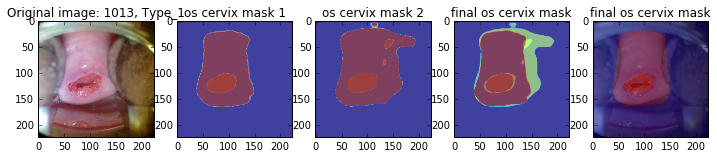

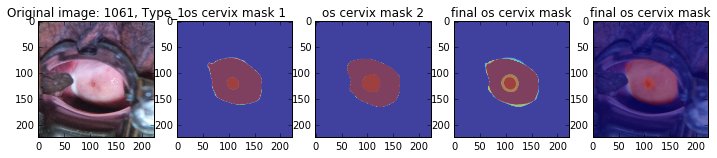

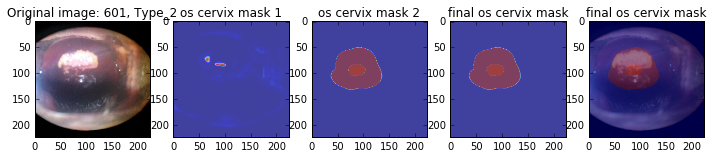

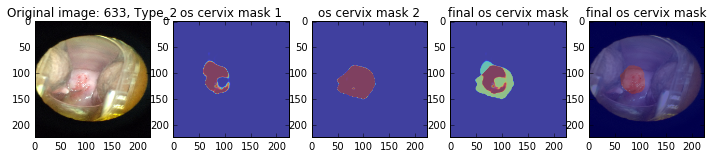

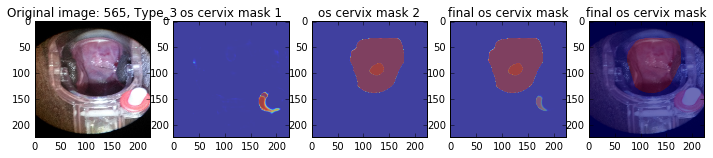

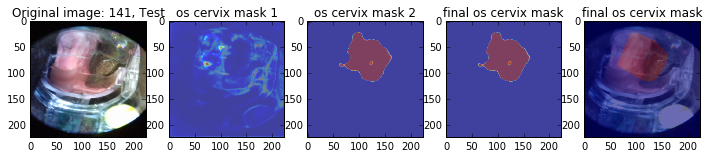

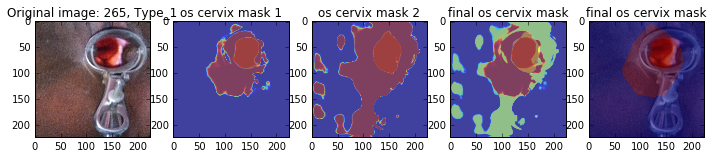

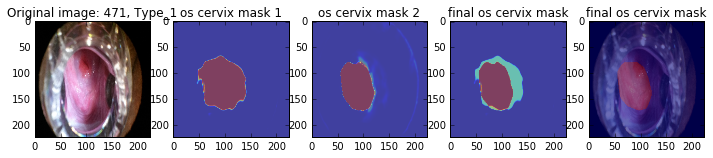

In [55]:
import cv2
import numpy as np
from postprocessing_utils import os_cervix_postproc

id_type_list = [('1013', 'Type_1'), 
                ('1061', 'Type_1'), 
                ('601', 'Type_2'), 
                ('633', 'Type_2'), 
                ('565', 'Type_3'), 
                ('141', 'Test'),
                ('265', 'Type_1'),                
                ('471', 'Type_1')]

def _resize(mask, size):
    mask = cv2.resize(mask, dsize=size, interpolation=cv2.INTER_NEAREST)
    return mask


def merge_masks(os_cervix_mask_1, os_cervix_mask_2):
    os_cervix_1_sum = np.sum(os_cervix_mask_1 > 0.5, axis=(0, 1))
    os_cervix_2_sum = np.sum(os_cervix_mask_2 > 0.5, axis=(0, 1))
    os_cervix_indices = np.abs(os_cervix_1_sum - os_cervix_2_sum) * 1.0 / (os_cervix_1_sum + os_cervix_2_sum + 1e-7)    
    
    final_os_cervix_mask = np.zeros_like(os_cervix_mask_1)    
    for i in range(2):
        if os_cervix_indices[i] < 0.5:
            final_os_cervix_mask[:,:,i] = 0.45 * os_cervix_mask_1[:,:,i] + 0.55 * os_cervix_mask_2[:,:,i]
        else:
            if os_cervix_1_sum[i] > os_cervix_2_sum[i]:
                final_os_cervix_mask[:,:,i] = os_cervix_mask_1[:,:,i]
            else:
                final_os_cervix_mask[:,:,i] = os_cervix_mask_2[:,:,i]
    return final_os_cervix_mask
    

for image_id, image_type in id_type_list:

    img = get_image_data(image_id, image_type)
    os_cervix_mask_1 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_1')
    os_cervix_mask_2 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_2')
    img = _resize(img, os_cervix_mask_1.shape[:2][::-1])
        
    print("os cervix mask 1 : ", np.sum(os_cervix_mask_1[:,:,0] > 0.5), np.sum(os_cervix_mask_1[:,:,1] > 0.5))    
    print("os cervix mask 2 : ", np.sum(os_cervix_mask_2[:,:,0] > 0.5), np.sum(os_cervix_mask_2[:,:,1] > 0.5))    
    
    os_1 = np.sum(os_cervix_mask_1[:,:,0] > 0.5)
    os_2 = np.sum(os_cervix_mask_2[:,:,0] > 0.5)
    os_min = min(os_1, os_2)
    cervix_1 = np.sum(os_cervix_mask_1[:,:,1] > 0.5)
    cervix_2 = np.sum(os_cervix_mask_2[:,:,1] > 0.5)

    os_index = np.abs(os_1 - os_2) * 1.0/(os_1 + os_2 + 1e-7)    
    print("os_index: ", os_index)    
    cervix_index = np.abs(cervix_1 - cervix_2) * 1.0 /(cervix_1 + cervix_2)    
    print("cervix_index: ", cervix_index)
        
    final_os_cervix_mask = merge_masks(os_cervix_mask_1, os_cervix_mask_2)
    final_os_cervix_mask_2 = os_cervix_postproc(final_os_cervix_mask)
    
    plt_st(12, 6)
    plt.subplot(151)
    plt.imshow(img)
    plt.title("Original image: %s, %s" % (image_id, image_type))
    plt.subplot(152)
    plt.imshow(os_cervix_mask_1[:,:,0], alpha=0.5, cmap='jet')    
    plt.imshow(os_cervix_mask_1[:,:,1], alpha=0.5, cmap='jet')
    plt.title("os cervix mask 1")
    plt.subplot(153)
    plt.imshow(os_cervix_mask_2[:,:,0], alpha=0.5, cmap='jet')
    plt.imshow(os_cervix_mask_2[:,:,1], alpha=0.5, cmap='jet')
    plt.title("os cervix mask 2")        
    plt.subplot(154)
    plt.imshow(final_os_cervix_mask[:,:,0], alpha=0.5, cmap='jet')
    plt.imshow(final_os_cervix_mask[:,:,1], alpha=0.5, cmap='jet')
    plt.title("final os cervix mask")        
    plt.subplot(155)
    plt.imshow(img)
    plt.imshow(final_os_cervix_mask_2[:,:,0], alpha=0.35, cmap='jet')
    plt.imshow(final_os_cervix_mask_2[:,:,1], alpha=0.35, cmap='jet')
    plt.title("final os cervix mask")        

## Create final os/cervix mask 

In [7]:
# Remove corrupted training image
all_trainval_id_type_list.remove(('1339', 'Type_1'))

In [57]:
from postprocessing_utils import os_cervix_postproc

counter = 1
ll = len(all_trainval_id_type_list)
for image_id, image_type in all_trainval_id_type_list:
    os_cervix_mask_1 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_1')
    os_cervix_mask_2 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_2')    
    final_os_cervix_mask = merge_masks(os_cervix_mask_1, os_cervix_mask_2)    
    final_os_cervix_mask = os_cervix_postproc(final_os_cervix_mask)
    print('-- %i / %i : %s, %s' % (counter, ll, image_id, image_type))   
    imwrite(final_os_cervix_mask, image_id + '_' + image_type, 'os_cervix_label')
    counter += 1

-- 1 / 1992 : 0, Type_1
-- 2 / 1992 : 10, Type_1
-- 3 / 1992 : 1013, Type_1
-- 4 / 1992 : 1014, Type_1
-- 5 / 1992 : 1019, Type_1
-- 6 / 1992 : 102, Type_1
-- 7 / 1992 : 1023, Type_1
-- 8 / 1992 : 1024, Type_1
-- 9 / 1992 : 1026, Type_1
-- 10 / 1992 : 1027, Type_1
-- 11 / 1992 : 1033, Type_1
-- 12 / 1992 : 104, Type_1
-- 13 / 1992 : 1040, Type_1
-- 14 / 1992 : 1056, Type_1
-- 15 / 1992 : 1059, Type_1
-- 16 / 1992 : 1061, Type_1
-- 17 / 1992 : 1070, Type_1
-- 18 / 1992 : 1071, Type_1
-- 19 / 1992 : 1077, Type_1
-- 20 / 1992 : 1079, Type_1
-- 21 / 1992 : 109, Type_1
-- 22 / 1992 : 1093, Type_1
-- 23 / 1992 : 1100, Type_1
-- 24 / 1992 : 1105, Type_1
-- 25 / 1992 : 1123, Type_1
-- 26 / 1992 : 1131, Type_1
-- 27 / 1992 : 1134, Type_1
-- 28 / 1992 : 1136, Type_1
-- 29 / 1992 : 1139, Type_1
-- 30 / 1992 : 1154, Type_1
-- 31 / 1992 : 1161, Type_1
-- 32 / 1992 : 1168, Type_1
-- 33 / 1992 : 1174, Type_1
-- 34 / 1992 : 1179, Type_1
-- 35 / 1992 : 1190, Type_1
-- 36 / 1992 : 1194, Type_1
-- 37 / 1

In [74]:
[_id for _id in type_2_ids if _id[0] == '4']

['4',
 '40',
 '400',
 '403',
 '404',
 '406',
 '407',
 '408',
 '410',
 '411',
 '412',
 '413',
 '414',
 '418',
 '419',
 '42',
 '420',
 '423',
 '428',
 '429',
 '43',
 '432',
 '437',
 '438',
 '44',
 '440',
 '442',
 '443',
 '444',
 '445',
 '447',
 '448',
 '449',
 '45',
 '451',
 '452',
 '453',
 '455',
 '456',
 '457',
 '458',
 '46',
 '460',
 '461',
 '462',
 '464',
 '472',
 '473',
 '474',
 '476',
 '482',
 '483',
 '485',
 '486',
 '487',
 '488',
 '490',
 '493',
 '496',
 '499']

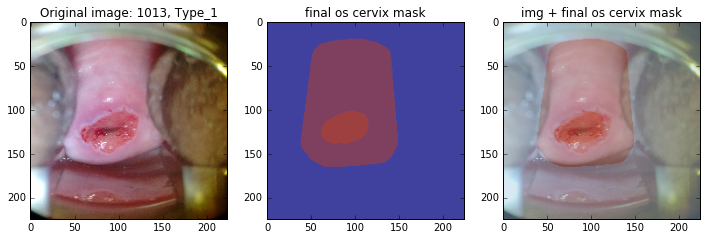

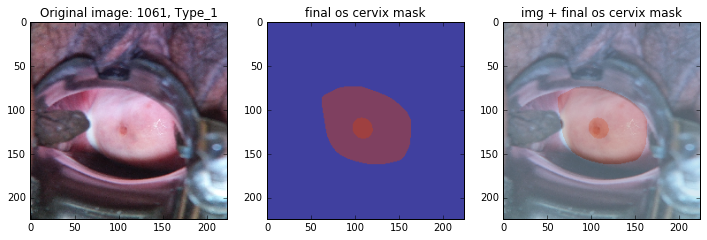

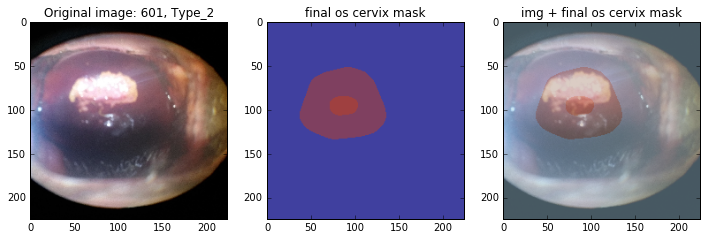

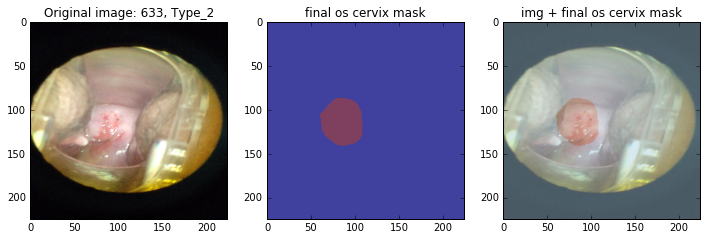

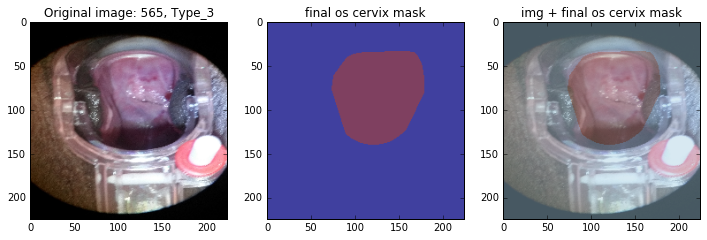

...

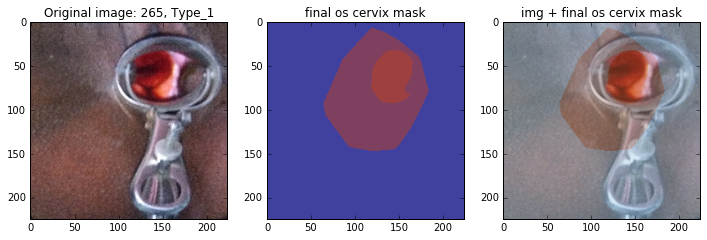

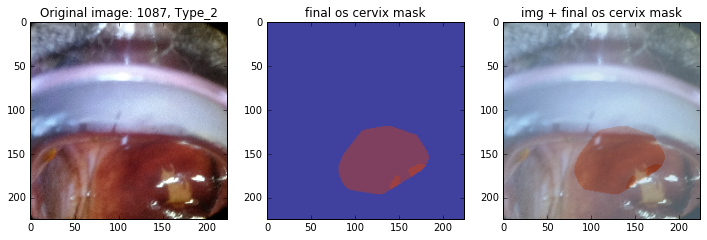

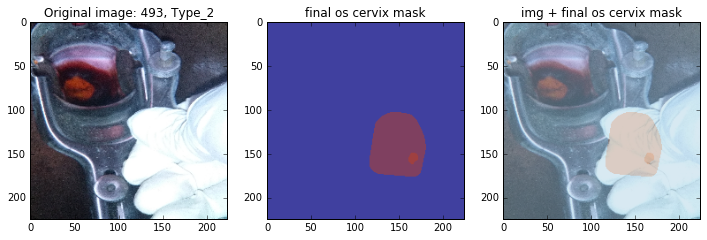

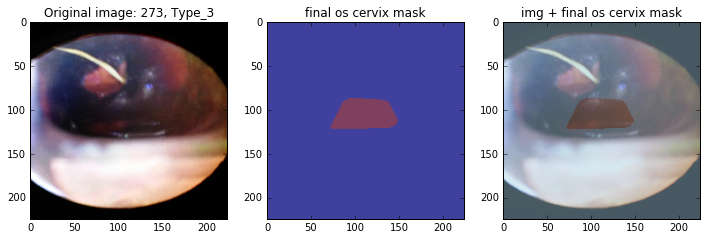

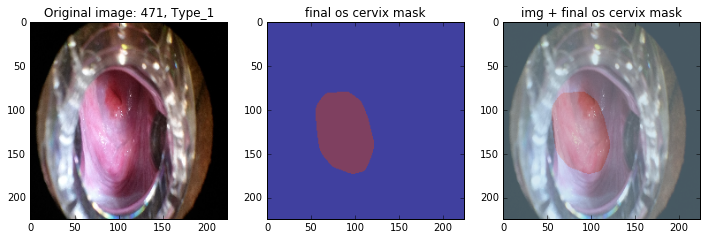

In [75]:
id_type_list = [('1013', 'Type_1'), 
                ('1061', 'Type_1'), 
                ('601', 'Type_2'), 
                ('633', 'Type_2'), 
                ('565', 'Type_3'), 
                ('141', 'Test'),
                ('265', 'Type_1'),
                ('1087', 'Type_2'),  
                ('493', 'Type_2'),  
                ('273', 'Type_3'),                  
                ('471', 'Type_1')]

for image_id, image_type in id_type_list:
    img = get_image_data(image_id, image_type)
    final_os_cervix_mask = get_image_data(image_id + "_" + image_type, 'os_cervix_label')
    
    img = cv2.resize(img, dsize=final_os_cervix_mask.shape[:2][::-1], interpolation=cv2.INTER_NEAREST)
    
    plt_st(12, 6)
    plt.subplot(131)
    plt.imshow(img)
    plt.title("Original image: %s, %s" % (image_id, image_type))
    plt.subplot(132)
    plt.imshow(final_os_cervix_mask[:,:,0], alpha=0.5, cmap='jet')    
    plt.imshow(final_os_cervix_mask[:,:,1], alpha=0.5, cmap='jet')
    plt.title("final os cervix mask")
    plt.subplot(133)
    plt.imshow(img)
    plt.imshow(final_os_cervix_mask[:,:,0], alpha=0.25, cmap='Paired')
    plt.imshow(final_os_cervix_mask[:,:,1], alpha=0.25, cmap='Paired')
    plt.title("img + final os cervix mask")


### Create masked images of os and cervix of 224x224 size

In [59]:
from postprocessing_utils import crop_to_mask

In [61]:
counter = 1
ll = len(all_trainval_id_type_list)

no_os_detected_id_type_list = []
no_cervix_detected_id_type_list = []

for image_id, image_type in all_trainval_id_type_list:
    print('-- %i / %i : %s, %s' % (counter, ll, image_id, image_type))   

    img = get_image_data(image_id, image_type)
    os_cervix = get_image_data(image_id + "_" + image_type, "os_cervix_label")
    os_cervix = cv2.resize(os_cervix, dsize=img.shape[:2][::-1], interpolation=cv2.INTER_NEAREST)

    cervix_mask = os_cervix[:, :, 1]
    if np.sum(cervix_mask) > 0:
        img_cervix = crop_to_mask(img, cervix_mask)
        img_cervix = cv2.resize(img_cervix, dsize=(224, 224), interpolation=cv2.INTER_NEAREST)
        imwrite(img_cervix, image_id, image_type + '_cervix')
    else:
        print("No cervix detected on the image: %s, %s" % (image_id, image_type))
        no_cervix_detected_id_type_list.append((image_id, image_type))
        
    os_mask = os_cervix[:, :, 0]
    if np.sum(os_mask) > 0:
        img_os = crop_to_mask(img, os_mask)
        img_os = cv2.resize(img_os, dsize=(224, 224), interpolation=cv2.INTER_NEAREST)        
        imwrite(img_os, image_id, image_type + '_os')
    else:
        # Write cervix instead of os
        print("No os detected on the image: %s, %s" % (image_id, image_type))
        imwrite(img_cervix, image_id, image_type + '_os')
        no_os_detected_id_type_list.append((image_id, image_type))
        
    counter += 1

-- 1 / 1992 : 0, Type_1
-- 2 / 1992 : 10, Type_1
-- 3 / 1992 : 1013, Type_1
-- 4 / 1992 : 1014, Type_1
-- 5 / 1992 : 1019, Type_1
-- 6 / 1992 : 102, Type_1
-- 7 / 1992 : 1023, Type_1
-- 8 / 1992 : 1024, Type_1
-- 9 / 1992 : 1026, Type_1
-- 10 / 1992 : 1027, Type_1
-- 11 / 1992 : 1033, Type_1
-- 12 / 1992 : 104, Type_1
-- 13 / 1992 : 1040, Type_1
-- 14 / 1992 : 1056, Type_1
-- 15 / 1992 : 1059, Type_1
-- 16 / 1992 : 1061, Type_1
-- 17 / 1992 : 1070, Type_1
-- 18 / 1992 : 1071, Type_1
-- 19 / 1992 : 1077, Type_1
-- 20 / 1992 : 1079, Type_1
-- 21 / 1992 : 109, Type_1
-- 22 / 1992 : 1093, Type_1
-- 23 / 1992 : 1100, Type_1
-- 24 / 1992 : 1105, Type_1
-- 25 / 1992 : 1123, Type_1
-- 26 / 1992 : 1131, Type_1
-- 27 / 1992 : 1134, Type_1
-- 28 / 1992 : 1136, Type_1
-- 29 / 1992 : 1139, Type_1
-- 30 / 1992 : 1154, Type_1
-- 31 / 1992 : 1161, Type_1
-- 32 / 1992 : 1168, Type_1
-- 33 / 1992 : 1174, Type_1
-- 34 / 1992 : 1179, Type_1
-- 35 / 1992 : 1190, Type_1
-- 36 / 1992 : 1194, Type_1
-- 37 / 1

In [62]:
no_cervix_detected_id_type_list

[]

In [63]:
no_os_detected_id_type_list

[('1326', 'Type_1'),
 ('181', 'Type_1'),
 ('471', 'Type_1'),
 ('1022', 'Type_2'),
 ('1152', 'Type_2'),
 ('1249', 'Type_2'),
 ('1331', 'Type_2'),
 ('326', 'Type_2'),
 ('486', 'Type_2'),
 ('633', 'Type_2'),
 ('772', 'Type_2'),
 ('974', 'Type_2'),
 ('1048', 'Type_3'),
 ('124', 'Type_3'),
 ('1270', 'Type_3'),
 ('179', 'Type_3'),
 ('249', 'Type_3'),
 ('352', 'Type_3'),
 ('390', 'Type_3'),
 ('510', 'Type_3'),
 ('565', 'Type_3'),
 ('625', 'Type_3'),
 ('778', 'Type_3'),
 ('175', 'Test'),
 ('178', 'Test'),
 ('240', 'Test'),
 ('266', 'Test'),
 ('461', 'Test'),
 ('55', 'Test')]

### Create masked images of os and cervix of 299x299 size

In [5]:
from postprocessing_utils import crop_to_mask
import cv2

In [8]:
counter = 1
ll = len(all_trainval_id_type_list)

no_os_detected_id_type_list = []
no_cervix_detected_id_type_list = []

for image_id, image_type in all_trainval_id_type_list:
    print('-- %i / %i : %s, %s' % (counter, ll, image_id, image_type))   

    img = get_image_data(image_id, image_type)
    os_cervix = get_image_data(image_id + "_" + image_type, "os_cervix_label")
    os_cervix = cv2.resize(os_cervix, dsize=img.shape[:2][::-1], interpolation=cv2.INTER_NEAREST)

    cervix_mask = os_cervix[:, :, 1]
    if np.sum(cervix_mask) > 0:
        img_cervix = crop_to_mask(img, cervix_mask)
        img_cervix = cv2.resize(img_cervix, dsize=(299, 299), interpolation=cv2.INTER_NEAREST)
        imwrite(img_cervix, image_id, image_type + '_cervix')
    else:
        print("No cervix detected on the image: %s, %s" % (image_id, image_type))
        no_cervix_detected_id_type_list.append((image_id, image_type))
        
    os_mask = os_cervix[:, :, 0]
    if np.sum(os_mask) > 0:
        img_os = crop_to_mask(img, os_mask)
        img_os = cv2.resize(img_os, dsize=(299, 299), interpolation=cv2.INTER_NEAREST)        
        imwrite(img_os, image_id, image_type + '_os')
    else:
        # Write cervix instead of os
        print("No os detected on the image: %s, %s" % (image_id, image_type))
        imwrite(img_cervix, image_id, image_type + '_os')
        no_os_detected_id_type_list.append((image_id, image_type))
        
    counter += 1

-- 1 / 1992 : 0, Type_1
-- 2 / 1992 : 10, Type_1
-- 3 / 1992 : 1013, Type_1
-- 4 / 1992 : 1014, Type_1
-- 5 / 1992 : 1019, Type_1
-- 6 / 1992 : 102, Type_1
-- 7 / 1992 : 1023, Type_1
-- 8 / 1992 : 1024, Type_1
-- 9 / 1992 : 1026, Type_1
-- 10 / 1992 : 1027, Type_1
-- 11 / 1992 : 1033, Type_1
-- 12 / 1992 : 104, Type_1
-- 13 / 1992 : 1040, Type_1
-- 14 / 1992 : 1056, Type_1
-- 15 / 1992 : 1059, Type_1
-- 16 / 1992 : 1061, Type_1
-- 17 / 1992 : 1070, Type_1
-- 18 / 1992 : 1071, Type_1
-- 19 / 1992 : 1077, Type_1
-- 20 / 1992 : 1079, Type_1
-- 21 / 1992 : 109, Type_1
-- 22 / 1992 : 1093, Type_1
-- 23 / 1992 : 1100, Type_1
-- 24 / 1992 : 1105, Type_1
-- 25 / 1992 : 1123, Type_1
-- 26 / 1992 : 1131, Type_1
-- 27 / 1992 : 1134, Type_1
-- 28 / 1992 : 1136, Type_1
-- 29 / 1992 : 1139, Type_1
-- 30 / 1992 : 1154, Type_1
-- 31 / 1992 : 1161, Type_1
-- 32 / 1992 : 1168, Type_1
-- 33 / 1992 : 1174, Type_1
-- 34 / 1992 : 1179, Type_1
-- 35 / 1992 : 1190, Type_1
-- 36 / 1992 : 1194, Type_1
-- 37 / 1

In [9]:
no_cervix_detected_id_type_list

[]

In [10]:
no_os_detected_id_type_list

[('1326', 'Type_1'),
 ('181', 'Type_1'),
 ('471', 'Type_1'),
 ('1022', 'Type_2'),
 ('1152', 'Type_2'),
 ('1249', 'Type_2'),
 ('1331', 'Type_2'),
 ('326', 'Type_2'),
 ('486', 'Type_2'),
 ('633', 'Type_2'),
 ('772', 'Type_2'),
 ('974', 'Type_2'),
 ('1048', 'Type_3'),
 ('124', 'Type_3'),
 ('1270', 'Type_3'),
 ('179', 'Type_3'),
 ('249', 'Type_3'),
 ('352', 'Type_3'),
 ('390', 'Type_3'),
 ('510', 'Type_3'),
 ('565', 'Type_3'),
 ('625', 'Type_3'),
 ('778', 'Type_3'),
 ('175', 'Test'),
 ('178', 'Test'),
 ('240', 'Test'),
 ('266', 'Test'),
 ('461', 'Test'),
 ('55', 'Test')]

## Display all generated training data

In [64]:
tile_size = (224, 224)
n = 15

complete_images = []
for k, type_ids in enumerate([type_1_ids, type_2_ids, type_3_ids]):
    m = int(np.ceil(len(type_ids) * 1.0 / n))
    complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
    train_ids = sorted(type_ids)
    counter = 0
    for i in range(m):
        ys = i*(tile_size[1] + 2)
        ye = ys + tile_size[1]
        for j in range(n):
            xs = j*(tile_size[0] + 2)
            xe = xs + tile_size[0]
            if counter == len(train_ids):
                break
            image_id = train_ids[counter]; counter+=1
            if image_id == '1339' and 'Type_1' == 'Type_%i' % (k+1):
                continue
            img = get_image_data(image_id, 'Type_%i_os' % (k+1))
            img = cv2.resize(img, dsize=tile_size)
            img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
            complete_image[ys:ye, xs:xe, :] = img[:,:,:]
        if counter == len(train_ids):
            break
    complete_images.append(complete_image)           

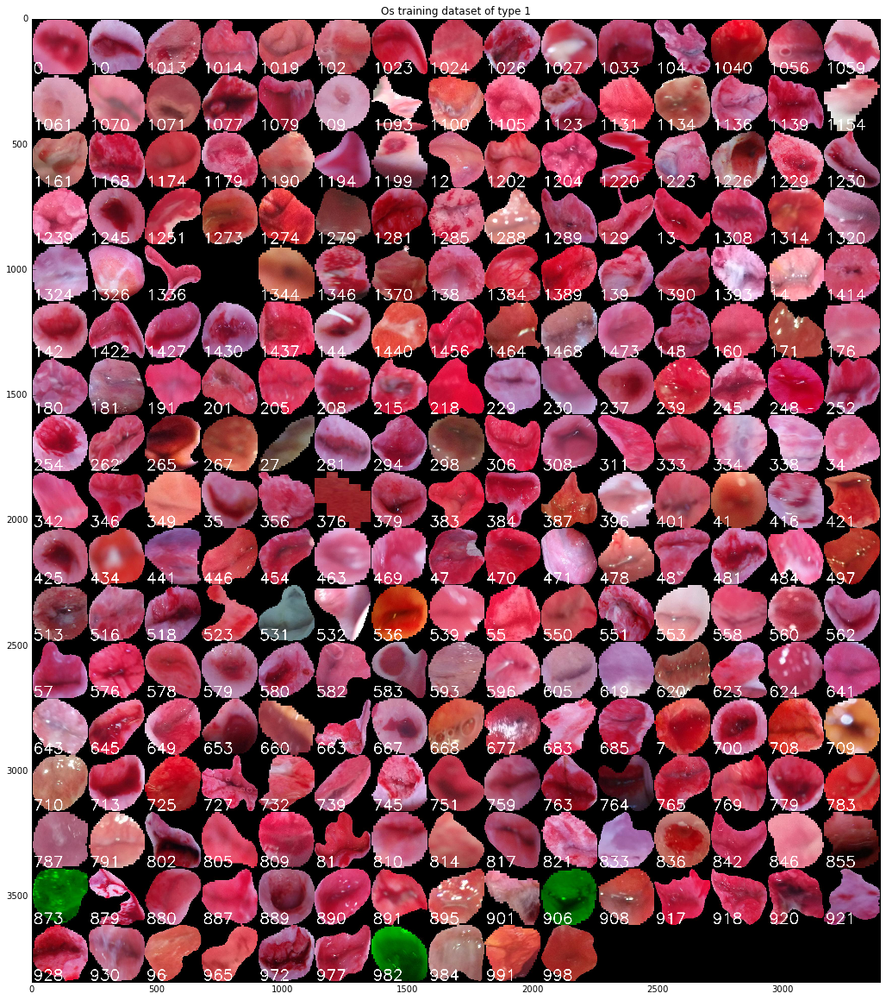

In [65]:
plt_st(20, 20)
plt.imshow(complete_images[0])
plt.title("Os training dataset of type %i" % (1))

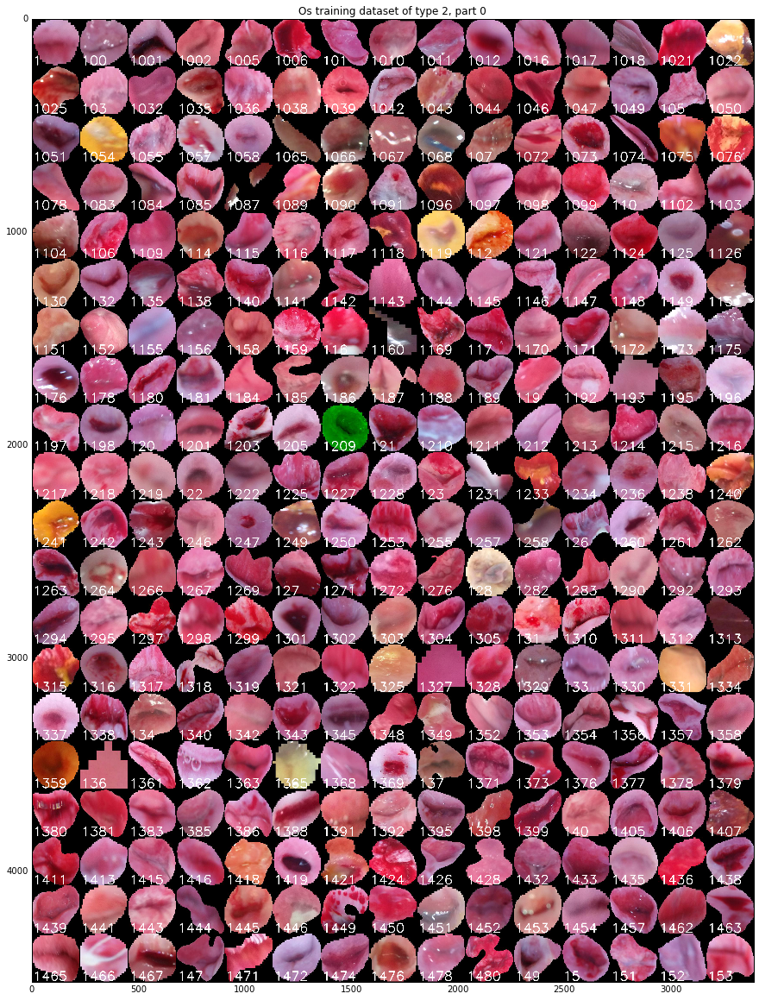

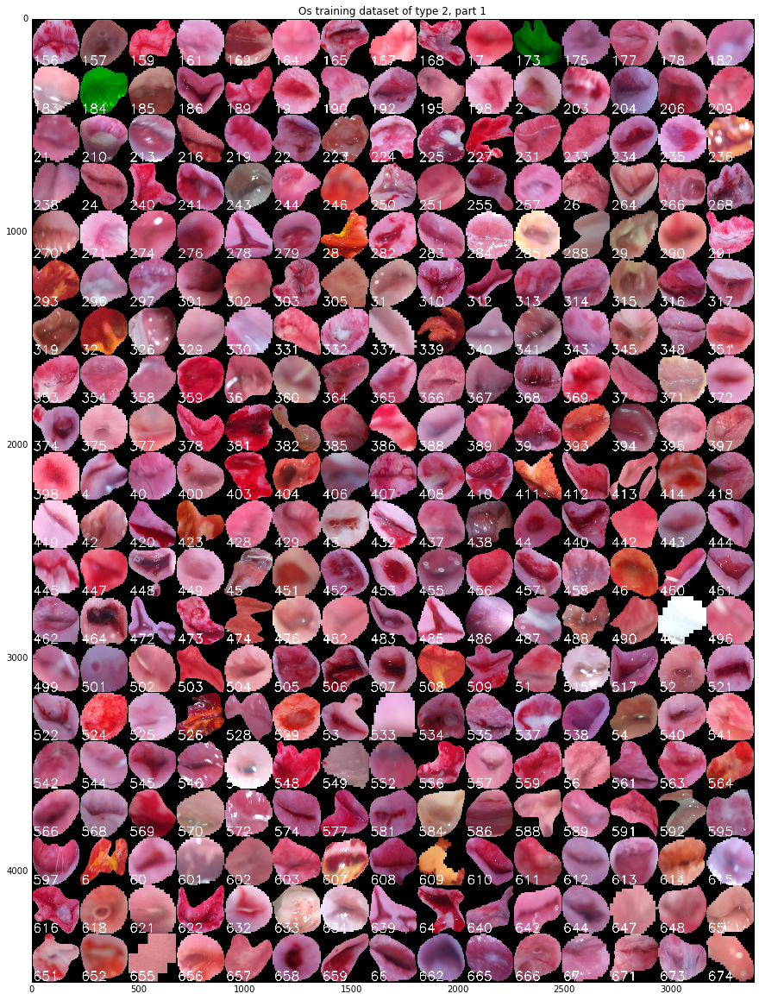

In [66]:
index = 1
m = complete_images[index].shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 20))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_images[index].shape[0])
    plt.imshow(complete_images[index][ys:ye,:,:])
    plt.title("Os training dataset of type %i, part %i" % (index + 1, i))

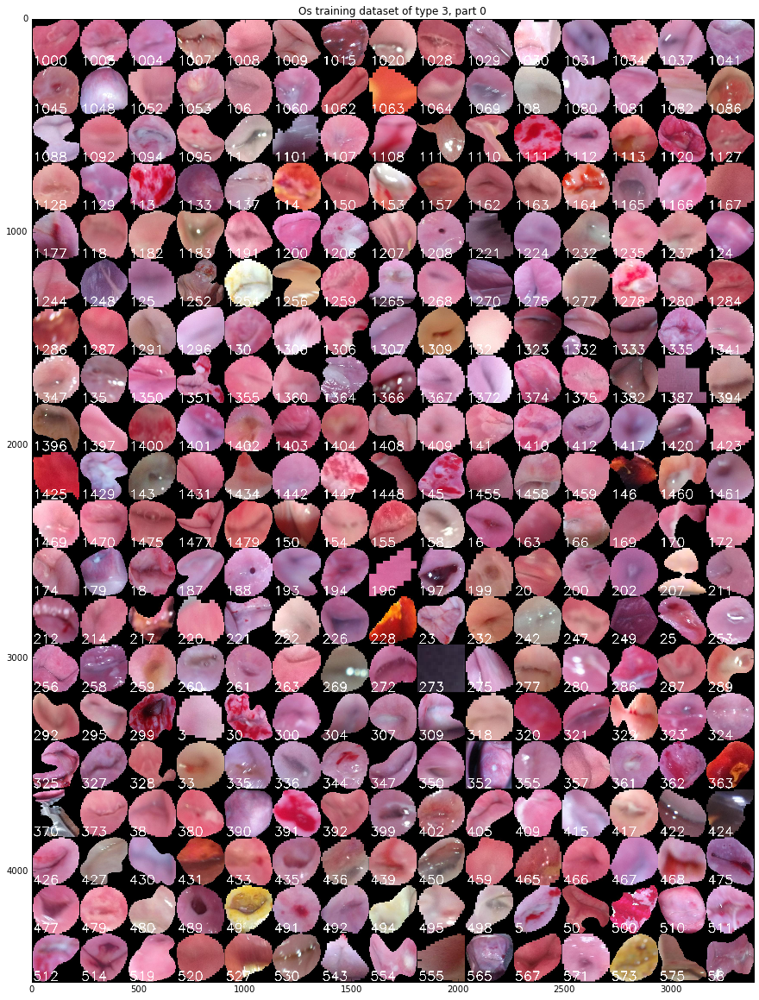

In [67]:
index = 2
m = complete_images[index].shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 20))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_images[index].shape[0])
    plt.imshow(complete_images[index][ys:ye,:,:])
    plt.title("Os training dataset of type %i, part %i" % (index + 1, i))

In [68]:
tile_size = (224, 224)
n = 15

complete_images = []
for k, type_ids in enumerate([type_1_ids, type_2_ids, type_3_ids]):
    m = int(np.ceil(len(type_ids) * 1.0 / n))
    complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
    train_ids = sorted(type_ids)
    counter = 0
    for i in range(m):
        ys = i*(tile_size[1] + 2)
        ye = ys + tile_size[1]
        for j in range(n):
            xs = j*(tile_size[0] + 2)
            xe = xs + tile_size[0]
            if counter == len(train_ids):
                break
            image_id = train_ids[counter]; counter+=1
            if image_id == '1339' and 'Type_1' == 'Type_%i' % (k+1):
                continue            
            img = get_image_data(image_id, 'Type_%i_cervix' % (k+1))
            img = cv2.resize(img, dsize=tile_size)
            img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
            complete_image[ys:ye, xs:xe, :] = img[:,:,:]
        if counter == len(train_ids):
            break
    complete_images.append(complete_image)           

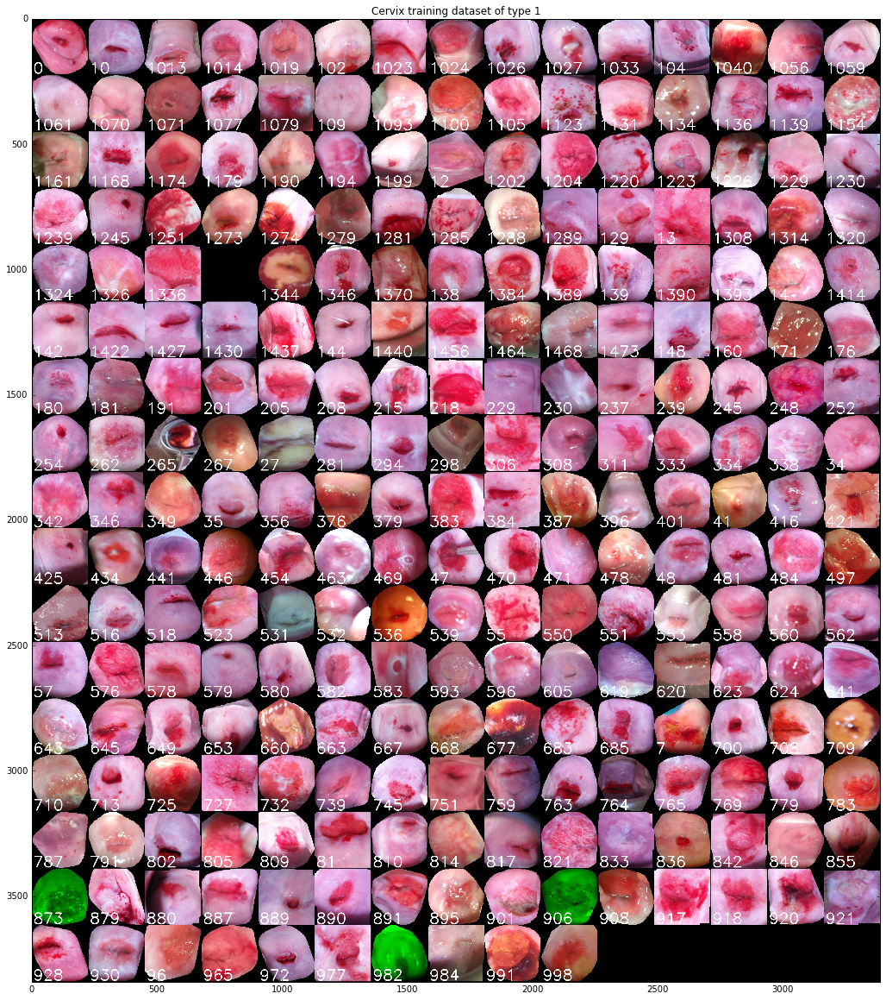

In [69]:
plt_st(20, 20)
plt.imshow(complete_images[0])
plt.title("Cervix training dataset of type %i" % (1))

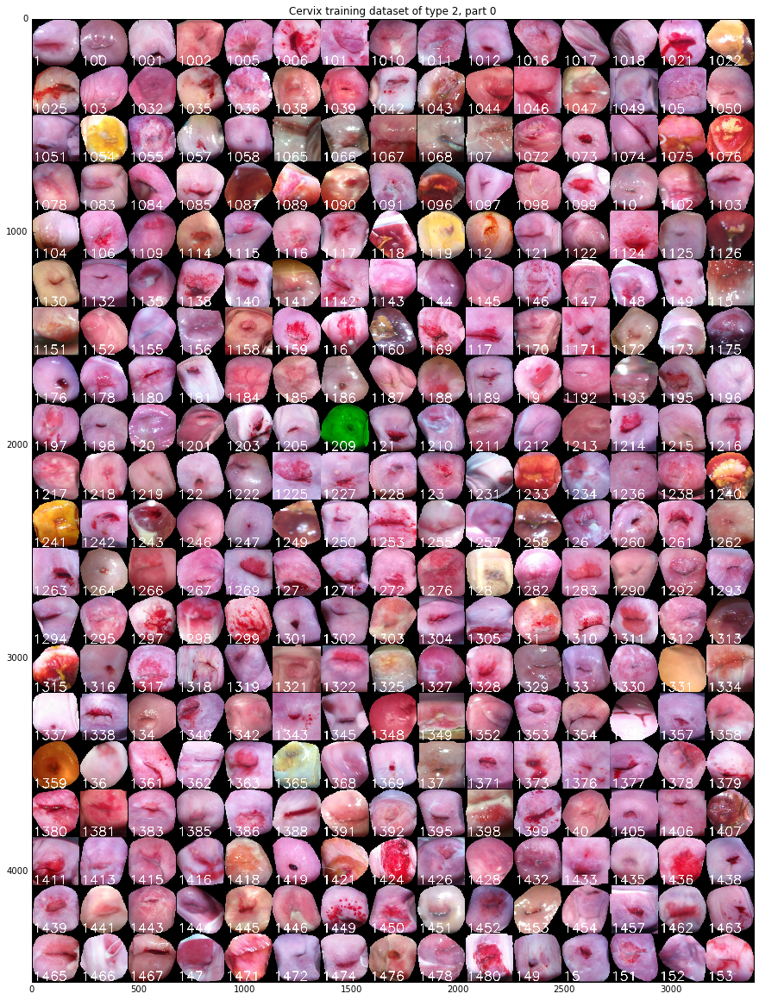

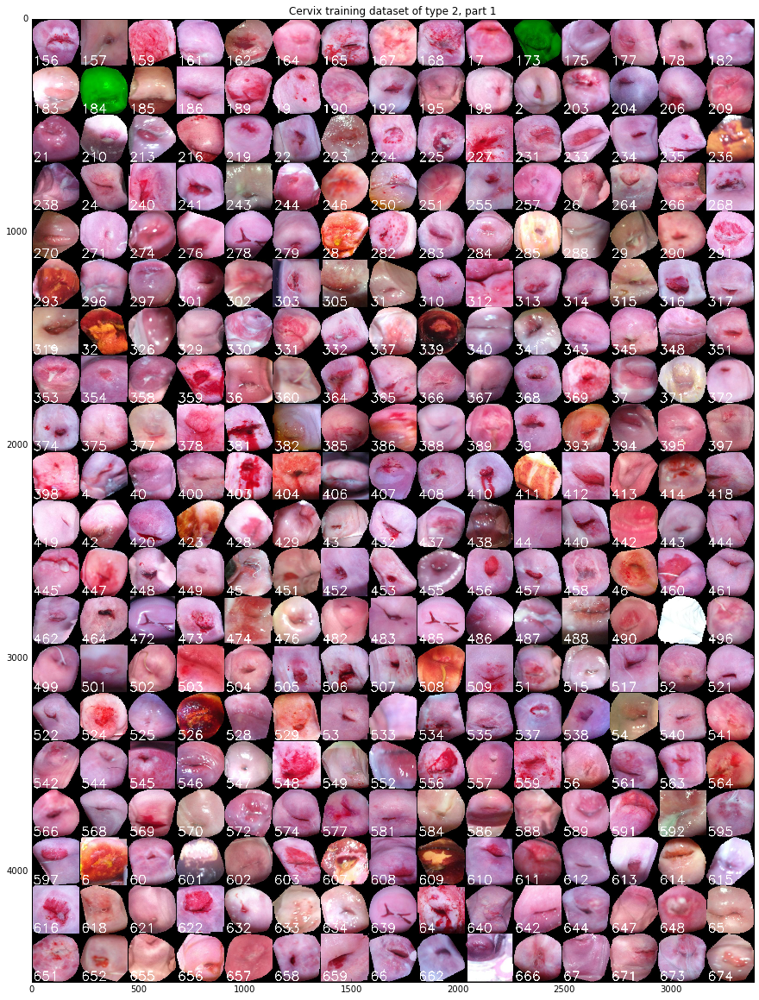

In [70]:
index = 1
m = complete_images[index].shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 20))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_images[index].shape[0])
    plt.imshow(complete_images[index][ys:ye,:,:])
    plt.title("Cervix training dataset of type %i, part %i" % (index + 1, i))

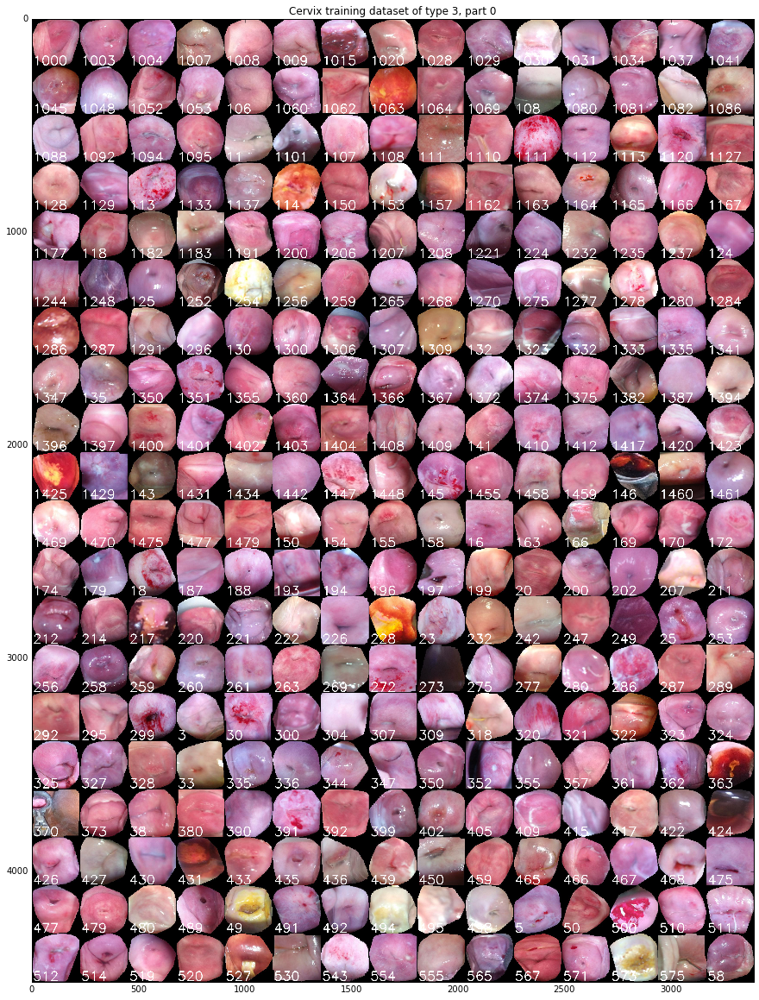

In [71]:
index = 2
m = complete_images[index].shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 20))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_images[index].shape[0])
    plt.imshow(complete_images[index][ys:ye,:,:])
    plt.title("Cervix training dataset of type %i, part %i" % (index + 1, i))

## Display all test images

In [7]:
import cv2

In [8]:
tile_size = (256, 256)
n = 15
m = int(np.ceil(len(test_ids) * 1.0 / n))
complete_test_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0
for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(test_ids):
            break
        image_id = test_ids[counter]; counter+=1
        img = get_image_data(image_id, 'Test_os')
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
        complete_test_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(test_ids):
        break

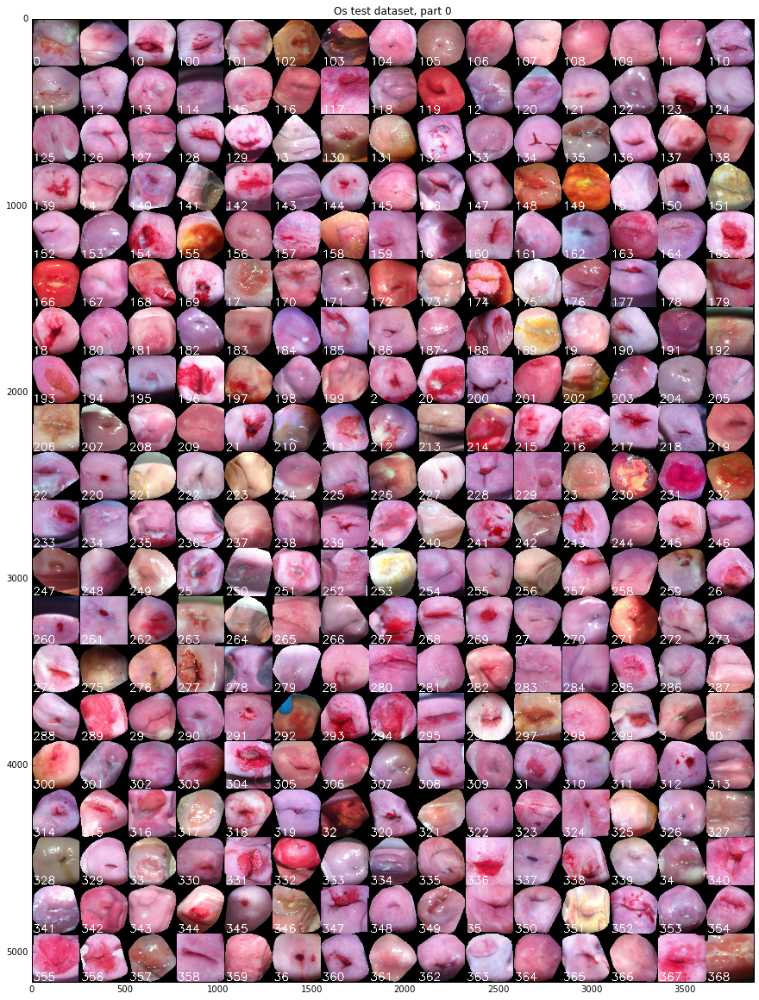

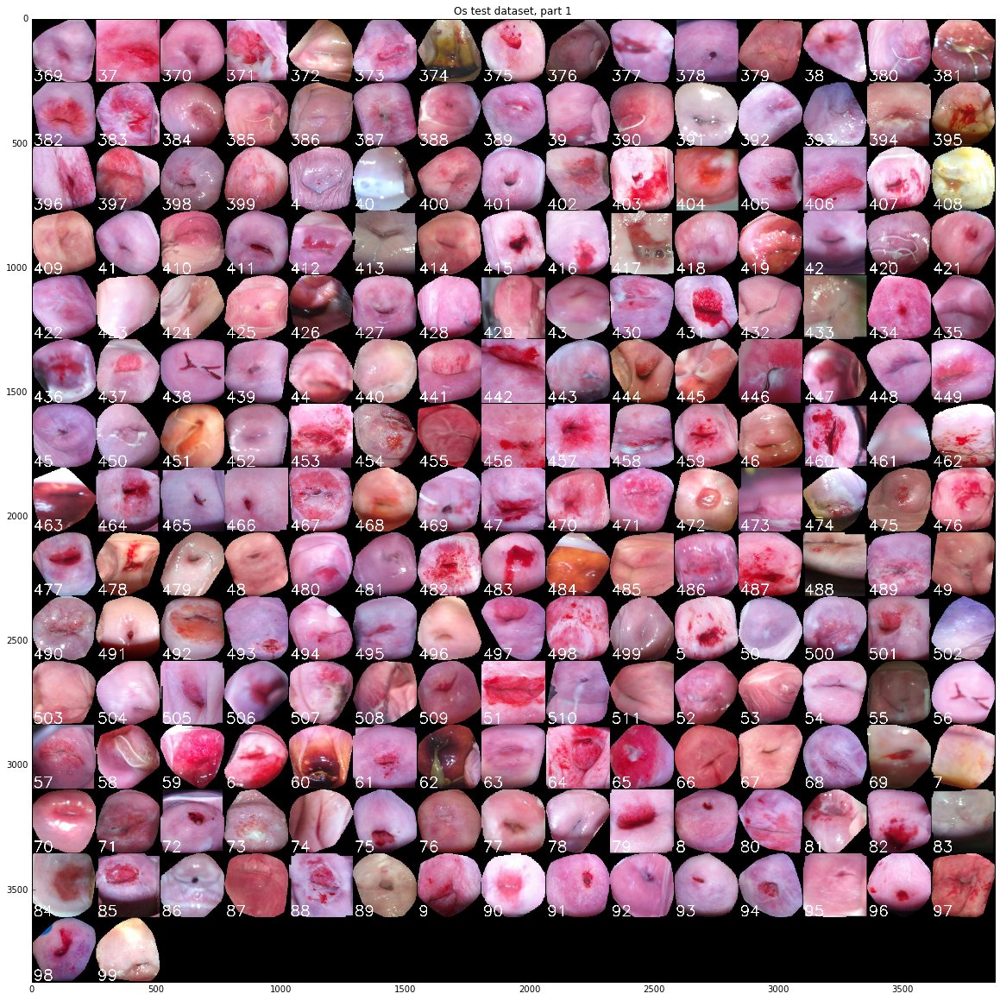

In [12]:
m = complete_test_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m * 1.0 / 20.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_test_image.shape[0])
    plt.imshow(complete_test_image[ys:ye,:,:])
    plt.title("Os test dataset, part %i" % (i))

In [15]:
len(test_ids)

512

In [10]:
tile_size = (256, 256)
n = 15
m = int(np.ceil(len(test_ids) * 1.0 / n))
complete_test_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0
for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(test_ids):
            break
        image_id = test_ids[counter]; counter+=1
        img = get_image_data(image_id, 'Test_cervix')
        img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
        complete_test_image[ys:ye, xs:xe, :] = img[:,:,:]
    if counter == len(test_ids):
        break

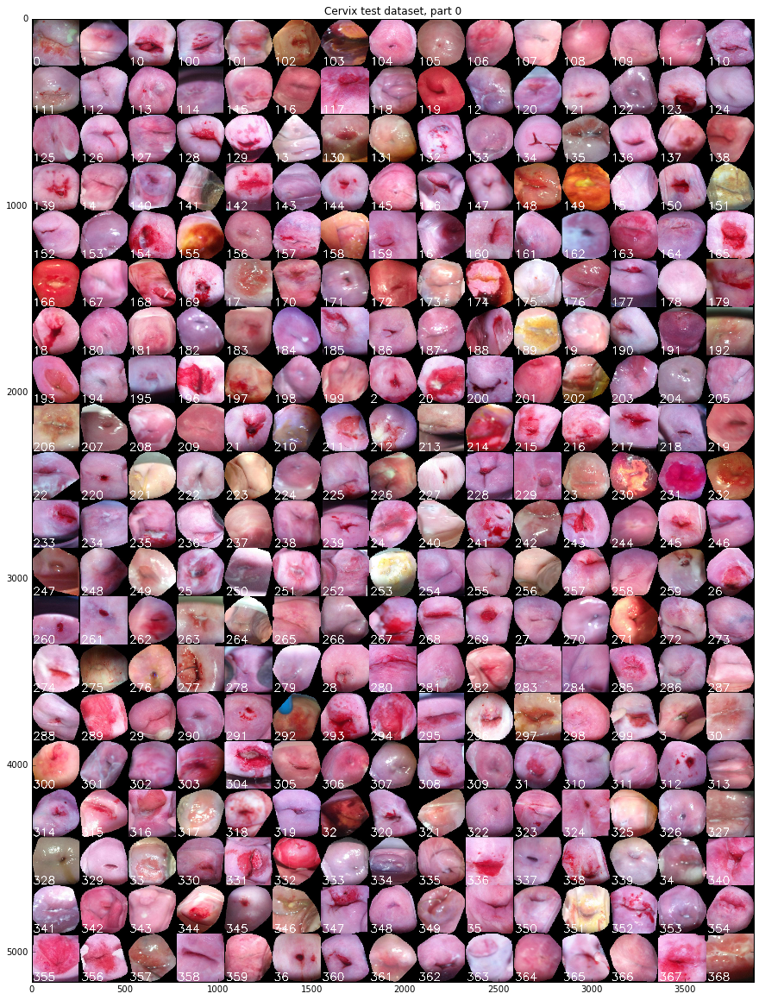

In [11]:
m = complete_test_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m * 1.0/ 20.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_test_image.shape[0])
    plt.imshow(complete_test_image[ys:ye,:,:])
    plt.title("Cervix test dataset, part %i" % (i))